# Monocular depth estimation

Monocular depth estimation is a computer vision task that involves predicting the depth information of a scene from a single image. In other words, it is the process of estimating the distance of objects in a scene from a single camera viewpoint.

Monocular depth estimation has various applications, including 3D reconstruction, augmented reality, autonomous driving, and robotics. It is a challenging task as it requires the model to understand the complex relationships between objects in the scene and the corresponding depth information, which can be affected by factors such as lighting conditions, occlusion, and texture.

There are two main depth estimation categories:

Absolute depth estimation: This task variant aims to provide exact depth measurements from the camera's perspective. The term is used interchangeably with metric depth estimation, where depth is provided in precise measurements in meters or feet. Absolute depth estimation models output depth maps with numerical values that represent real-world distances.

Relative depth estimation: Relative depth estimation aims to predict the depth order of objects or points in a scene without providing the precise measurements. These models output a depth map that indicates which parts of the scene are closer or farther relative to each other without the actual distances to A and B.

In this guide, we will see how to:
1. Infer relative depth using Depth Anything V2, a state-of-the-art zero-shot relative depth estimation model.
2. Infer depth estimation using ZoeDepth, an absolute depth estimation model.

# Libraries

In [1]:
pip install -q -U transformers

Note: you may need to restart the kernel to use updated packages.


In [2]:

import torch
import requests
import matplotlib
import numpy as np
from PIL import Image
from transformers import pipeline, AutoImageProcessor, AutoModelForDepthEstimation

2024-09-23 20:25:02.557803: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE4.1 SSE4.2
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


# Relative depth estimation via HF pipeline

In [3]:
# Load DepthAnything model as checkpoint and send computation to GPU if available
device = "cuda" if torch.cuda.is_available() else "cpu"
checkpoint = "depth-anything/Depth-Anything-V2-base-hf"
pipe = pipeline("depth-estimation", model=checkpoint, device=device)

config.json:   0%|          | 0.00/953 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/390M [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/775 [00:00<?, ?B/s]

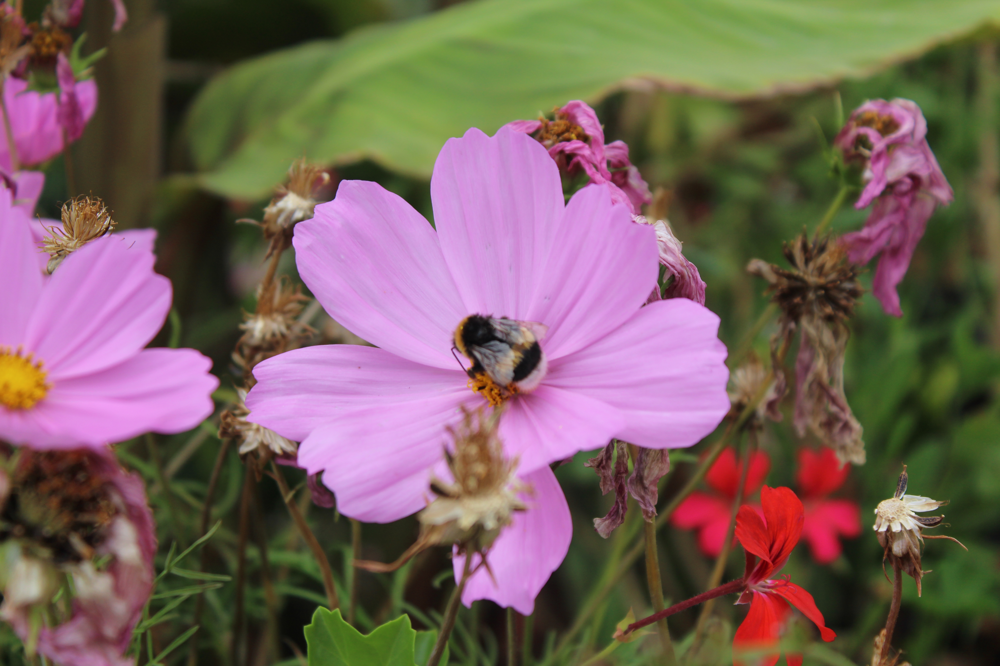

In [4]:
# Load image for analysis
url = "https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/bee.jpg"
image = Image.open(requests.get(url, stream=True).raw)
image

In [5]:
# Pass the image to the pipeline
# The pipeline returns a dictionary with two entries: predicted_depth and depth
# predicted_depth is a tensor with the values being the depth expressed in meters for each pixel
# depth is a PIL image that visualizes the depth estimation result
predictions = pipe(image)

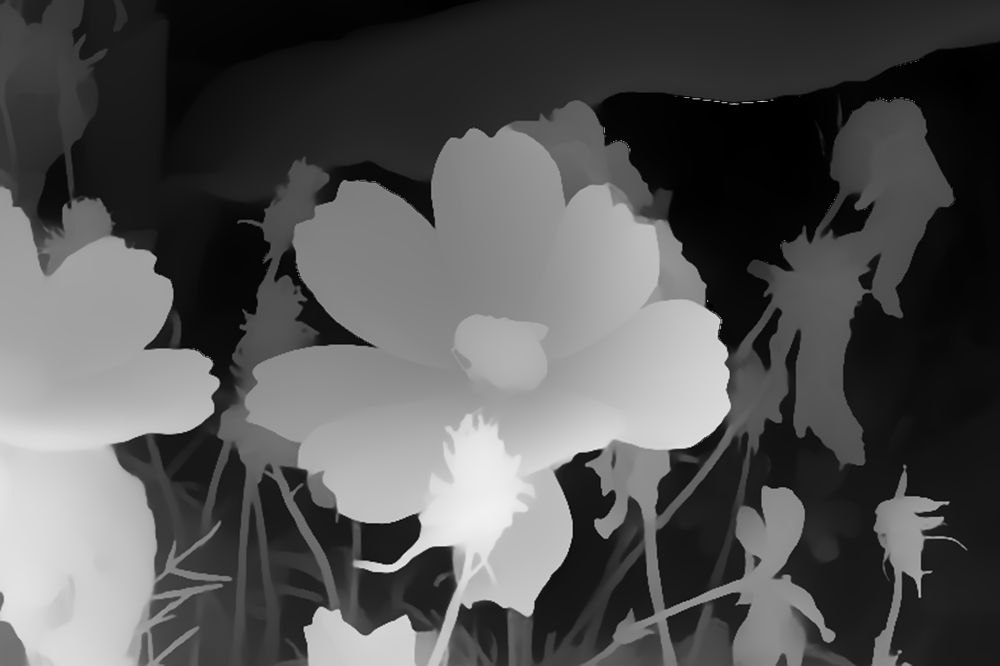

In [6]:
# Visualise the prediction
predictions["depth"]

# Relative depth estimation without pipeline

In [ ]:
# Load ZoeDepth model as checkpoint and send to GPU if available
checkpoint = "Intel/zoedepth-nyu-kitti"

image_processor = AutoImageProcessor.from_pretrained(checkpoint)
model = AutoModelForDepthEstimation.from_pretrained(checkpoint).to(device)

In [ ]:
# image_processor applies image transformations such as resizing and normalization
pixel_values = image_processor(image, return_tensors="pt").pixel_values.to(device)

In [ ]:
# Pass pre-processed inputs through model
with torch.no_grad():
    outputs = model(pixel_values)

In [ ]:
# Post-processing steps
# Pad and then resize the outputs so that predicted depth map has the same dimension as the original image
predicted_depth = outputs.predicted_depth.unsqueeze(dim=1)
height, width = pixel_values.shape[2:]
height_padding_factor = width_padding_factor = 3
pad_h = int(np.sqrt(height/2) * height_padding_factor)
pad_w = int(np.sqrt(width/2) * width_padding_factor)

if (predicted_depth.shape[-2:] != pixel_values.shape[-2:]):
    predicted_depth = torch.nn.functional.interpolate(predicted_depth, 
                                                     size= (height, width), 
                                                     mode='bicubic', 
                                                     align_corners=False)

# After resizing we will remove the padded regions from the depth
if pad_h > 0:
    predicted_depth = predicted_depth[:, :, pad_h:-pad_h,:]
if pad_w > 0:
    predicted_depth = predicted_depth[:, :, :, pad_w:-pad_w]

In [ ]:
# Prepare function to color image based on estimated depth
def colorize(value, vmin=None, vmax=None, cmap='gray_r', invalid_val=-99, invalid_mask=None, background_color=(128, 128, 128, 255), gamma_corrected=False, value_transform=None):
    """Converts a depth map to a color image.

    Args:
        value (torch.Tensor, numpy.ndarry): Input depth map. Shape: (H, W) or (1, H, W) or (1, 1, H, W). All singular dimensions are squeezed
        vmin (float, optional): vmin-valued entries are mapped to start color of cmap. If None, value.min() is used. Defaults to None.
        vmax (float, optional):  vmax-valued entries are mapped to end color of cmap. If None, value.max() is used. Defaults to None.
        cmap (str, optional): matplotlib colormap to use. Defaults to 'magma_r'.
        invalid_val (int, optional): Specifies value of invalid pixels that should be colored as 'background_color'. Defaults to -99.
        invalid_mask (numpy.ndarray, optional): Boolean mask for invalid regions. Defaults to None.
        background_color (tuple[int], optional): 4-tuple RGB color to give to invalid pixels. Defaults to (128, 128, 128, 255).
        gamma_corrected (bool, optional): Apply gamma correction to colored image. Defaults to False.
        value_transform (Callable, optional): Apply transform function to valid pixels before coloring. Defaults to None.

    Returns:
        numpy.ndarray, dtype - uint8: Colored depth map. Shape: (H, W, 4)
    """
    if isinstance(value, torch.Tensor):
        value = value.detach().cpu().numpy()

    value = value.squeeze()
    if invalid_mask is None:
        invalid_mask = value == invalid_val
    mask = np.logical_not(invalid_mask)

    # normalize
    vmin = np.percentile(value[mask],2) if vmin is None else vmin
    vmax = np.percentile(value[mask],85) if vmax is None else vmax
    if vmin != vmax:
        value = (value - vmin) / (vmax - vmin)  # vmin..vmax
    else:
        # Avoid 0-division
        value = value * 0.

    # squeeze last dim if it exists
    # grey out the invalid values
    value[invalid_mask] = np.nan
    cmapper = matplotlib.colormaps.get_cmap(cmap)
    if value_transform:
        value = value_transform(value)
    value = cmapper(value, bytes=True)
    img = value[...]
    img[invalid_mask] = background_color

    if gamma_corrected:
        img = img / 255
        img = np.power(img, 2.2)
        img = img * 255
        img = img.astype(np.uint8)
    return img


In [ ]:
# # Visualise the results
result = colorize(predicted_depth.cpu().squeeze().numpy())
Image.fromarray(result)